In [1]:
import torch
import torchvision
import torchvision.transforms as transforms

In [2]:
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

In [3]:
train_dataset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)

100%|██████████| 170M/170M [00:16<00:00, 10.1MB/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


In [4]:
train_size = int(0.8 * len(train_dataset))
validation_size = len(train_dataset) - train_size

train_set, validation_set = torch.utils.data.random_split(train_dataset, [train_size, validation_size])

train_loader = torch.utils.data.DataLoader(train_set,batch_size=16, shuffle=True)

val_loader = torch.utils.data.DataLoader(validation_set,batch_size=16)

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# CNN with Batch Normalization

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class CNN_BatchNorm(nn.Module):
    def __init__(self):
        super(CNN_BatchNorm, self).__init__()

        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(64)

        self.pool = nn.MaxPool2d(2, 2)

        self.fc1 = nn.Linear(64 * 4 * 4, 500)
        self.fc2 = nn.Linear(500, 10)
        self.dropout = nn.Dropout(0.25)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv3(x)
        x = self.bn3(x)
        x = F.relu(x)
        x = self.pool(x)

        x = x.view(-1, 64 * 4 * 4)
        x = self.dropout(x)

        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout(x)

        output = self.fc2(x)

        return output

# CNN without Batch Normalization

In [7]:
class CNN_without_BatchNorm(nn.Module):
    def __init__(self):
        super(CNN_without_BatchNorm, self).__init__()

        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)

        self.pool = nn.MaxPool2d(2, 2)

        self.fc1 = nn.Linear(64 * 4 * 4, 500)
        self.fc2 = nn.Linear(500, 10)
        self.dropout = nn.Dropout(0.25)

    def forward(self, x):

        x = self.conv1(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv2(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv3(x)
        x = F.relu(x)
        x = self.pool(x)

        x = x.view(-1, 64 * 4 * 4)
        x = self.dropout(x)

        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout(x)

        output = self.fc2(x)

        return output

# CNN with Noisy BatchNorm

In [8]:
class CNN_Noisy_BatchNorm(nn.Module):
    def __init__(self, n_mu=0.5, n_sigma=1.25, r_mu=0.1, r_sigma=0.1):
        super(CNN_Noisy_BatchNorm, self).__init__()

        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(64)

        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(64 * 4 * 4, 500)
        self.fc2 = nn.Linear(500, 10)
        self.dropout = nn.Dropout(0.25)

        self.n_mu = n_mu
        self.n_sigma = n_sigma
        self.r_mu = r_mu
        self.r_sigma = r_sigma

    def add_noise(self, x):
        mu_t = torch.FloatTensor(1).uniform_(-self.n_mu, self.n_mu).to(x.device)
        sigma_t = torch.FloatTensor(1).uniform_(1, self.n_sigma).to(x.device)

        mu_t = mu_t.item()
        sigma_t = sigma_t.item()

        m_t = torch.FloatTensor(x.size()).uniform_(mu_t - self.r_mu, mu_t + self.r_mu).to(x.device)
        s_t = torch.FloatTensor(x.size()).normal_(sigma_t, self.r_sigma).to(x.device)

        return s_t * x + m_t

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.add_noise(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv2(x)
        x = self.bn2(x)
        x = self.add_noise(x)
        x = F.relu(x)
        x = self.pool(x)

        x = self.conv3(x)
        x = self.bn3(x)
        x = self.add_noise(x)
        x = F.relu(x)
        x = self.pool(x)

        x = x.view(-1, 64 * 4 * 4)
        x = self.dropout(x)

        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout(x)

        output = self.fc2(x)

        return output

# Retreive and Store gradients magnitude while training

In [9]:
import matplotlib.pyplot as plt
import torch.optim as optim
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_with_bn = CNN_BatchNorm().to(device)
model_without_bn = CNN_without_BatchNorm().to(device)
model_noisy_bn = CNN_Noisy_BatchNorm().to(device)

criterion = nn.CrossEntropyLoss()
optimizer_with_bn = optim.SGD(model_with_bn.parameters(), lr=0.001, momentum=0.9)
optimizer_without_bn = optim.SGD(model_without_bn.parameters(), lr=0.001, momentum=0.9)
optimizer_noisy_bn = optim.SGD(model_noisy_bn.parameters(), lr=0.001, momentum=0.9)

n_epochs = 10

gradients_with_bn = []
gradients_without_bn = []
gradients_noisy_bn = []

def record_gradient_norms(model, gradient_list):
    for name, param in model.named_parameters():
        if param.grad is not None:
            gradient_list.append(param.grad.norm().item())

for epoch in range(n_epochs):
    model_with_bn.train()
    for data, target in train_loader:
        data, target = data.to(device), target.to(device)
        optimizer_with_bn.zero_grad()

        output = model_with_bn(data)
        loss = criterion(output, target)
        loss.backward()

        record_gradient_norms(model_with_bn, gradients_with_bn)

        optimizer_with_bn.step()

    model_without_bn.train()
    for data, target in train_loader:
        data, target = data.to(device), target.to(device)
        optimizer_without_bn.zero_grad()

        output2 = model_without_bn(data)
        loss2 = criterion(output2, target)
        loss2.backward()

        record_gradient_norms(model_without_bn, gradients_without_bn)

        optimizer_without_bn.step()


    model_noisy_bn.train()
    for data, target in train_loader:
        data, target = data.to(device), target.to(device)
        optimizer_noisy_bn.zero_grad()

        output3 = model_noisy_bn(data)
        loss3 = criterion(output3, target)
        loss3.backward()

        record_gradient_norms(model_noisy_bn, gradients_noisy_bn)

        optimizer_noisy_bn.step()

In [10]:
print(gradients_with_bn)

[1.1487367153167725, 7.080581667651131e-07, 0.0703180804848671, 0.03686854988336563, 1.4862245321273804, 1.8263929746353824e-07, 0.07270544022321701, 0.04424282908439636, 2.0040035247802734, 5.732743346698044e-08, 0.07264341413974762, 0.052421096712350845, 4.649260997772217, 0.09650065749883652, 3.574244737625122, 0.20434853434562683, 1.1336750984191895, 1.2574392940223333e-06, 0.05804557353258133, 0.04237576946616173, 1.5785338878631592, 1.4920389901362796e-07, 0.07324076443910599, 0.047192614525556564, 2.0888726711273193, 6.627715976037507e-08, 0.08561957627534866, 0.0664064958691597, 4.536415100097656, 0.1026448979973793, 3.2040188312530518, 0.2100442796945572, 1.6015070676803589, 8.258090815616015e-07, 0.055878136307001114, 0.053335923701524734, 1.6390458345413208, 1.1228498664195286e-07, 0.06258063018321991, 0.04428352043032646, 2.0703914165496826, 4.6814808030148924e-08, 0.0837884396314621, 0.06343336403369904, 4.6116228103637695, 0.1055266410112381, 3.1978936195373535, 0.2261293

In [11]:
print(gradients_without_bn)

[0.02880948781967163, 0.010361701250076294, 0.06766987591981888, 0.016956299543380737, 0.12231004238128662, 0.0566837415099144, 0.25434041023254395, 0.1142306998372078, 0.17863179743289948, 0.21963970363140106, 0.034952312707901, 0.016259973868727684, 0.08989626914262772, 0.03116043284535408, 0.1391744166612625, 0.06430909037590027, 0.3138037323951721, 0.132583349943161, 0.23722703754901886, 0.29847341775894165, 0.03223711624741554, 0.00894676148891449, 0.06717737764120102, 0.02256472408771515, 0.11098303645849228, 0.05432191118597984, 0.2486029714345932, 0.11257350444793701, 0.1945519745349884, 0.2648622989654541, 0.024055270478129387, 0.011767234653234482, 0.07015864551067352, 0.029445258900523186, 0.10424763709306717, 0.05718163400888443, 0.22431370615959167, 0.09629242867231369, 0.1676410585641861, 0.18247126042842865, 0.028443800285458565, 0.010393905453383923, 0.08430355042219162, 0.02674948237836361, 0.13980981707572937, 0.06246389448642731, 0.28284400701522827, 0.11585104465484

In [12]:
print(gradients_noisy_bn)

[1.9384560585021973, 8.03478997113416e-07, 0.14621497690677643, 0.08455101400613785, 2.0821337699890137, 2.5841572437457216e-07, 0.08787482976913452, 0.06420133262872696, 2.6372058391571045, 7.950166747150433e-08, 0.11508960276842117, 0.08034516125917435, 6.704617500305176, 0.09713397920131683, 4.291064739227295, 0.17468394339084625, 1.1215609312057495, 2.331677251277142e-06, 0.08475665748119354, 0.058534175157547, 1.8140170574188232, 1.3577322022229055e-07, 0.0884266123175621, 0.05702207237482071, 2.1921370029449463, 5.977526029710134e-08, 0.0903758853673935, 0.0795067846775055, 5.2603044509887695, 0.11727146804332733, 3.9729397296905518, 0.2891514003276825, 1.189906358718872, 9.652785593061708e-07, 0.07481266558170319, 0.049610551446676254, 1.488258719444275, 1.7800817886381992e-07, 0.06123463064432144, 0.04374466836452484, 2.0861003398895264, 5.363659028034817e-08, 0.09739949554204941, 0.05944602191448212, 3.790534734725952, 0.09932250529527664, 2.519944906234741, 0.1841541975736618

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


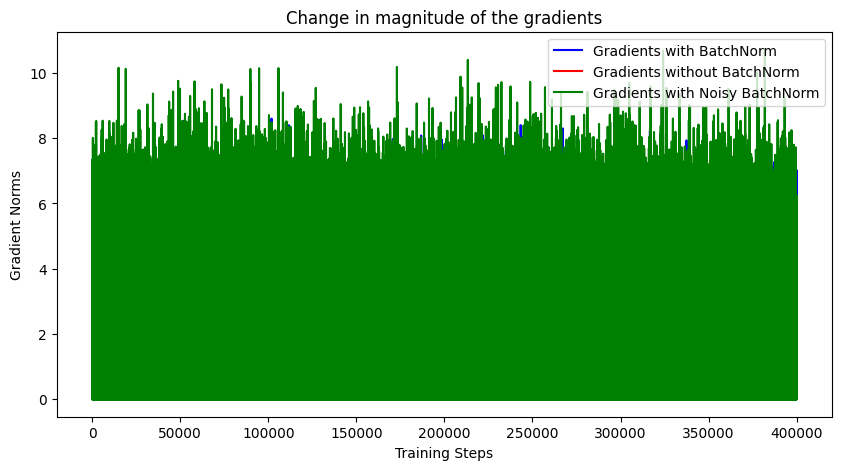

In [23]:
def plot_gradient_norms(gradients_with_bn, gradients_without_bn, gradients_noisy_bn):

    plt.figure(figsize=(10, 5))
    plt.plot(gradients_with_bn, label='Gradients with BatchNorm', color='b')
    plt.plot(gradients_without_bn, label='Gradients without BatchNorm', color='r')
    plt.plot(gradients_noisy_bn, label='Gradients with Noisy BatchNorm', color='g')
    plt.xlabel('Training Steps')
    plt.ylabel('Gradient Norms')
    plt.title('Change in magnitude of the gradients')
    plt.legend()
    plt.show()

plot_gradient_norms(gradients_with_bn, gradients_without_bn, gradients_noisy_bn)

The graph is not easily interpretable. So, we will smooth out the gradients value by taking moving average.

For e.g [5, 20, 25, 10, 30, 20, 15]    ---->    (5 + 20) / 2 = 12.5  ,  (20 + 25) / 2 = 22.5 and so on.
The result becomes [12.5, 22.5, 17.5, 25, 25, 17.5]

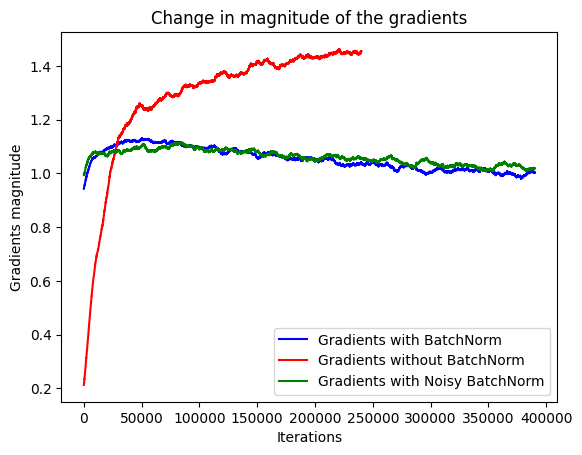

In [21]:
def smooth(gradients, window_size=10000):
    return np.convolve(gradients, np.ones(window_size)/window_size, mode='valid')

smooth_grad_with_bn = smooth(gradients_with_bn)
smooth_grad_without_bn = smooth(gradients_without_bn)
smooth_grad_noisy_bn = smooth(gradients_noisy_bn)

plt.plot(smooth_grad_with_bn, label='Gradients with BatchNorm', color='b')
plt.plot(smooth_grad_without_bn, label='Gradients without BatchNorm', color='r')
plt.plot(smooth_grad_noisy_bn, label='Gradients with Noisy BatchNorm', color='g')
plt.xlabel('Iterations')
plt.ylabel('Gradients magnitude')
plt.title('Change in magnitude of the gradients')
plt.legend()
plt.show()